In [1]:
# %load ../src/run_analysis_mapping_color_to_image.py
# %%
from manipulation_library_dev import plot_compare_mapped_image_save, get_image, get_colors, OcrAnalysis 
import easyocr , os , ssl
import matplotlib.pyplot as plt
import numpy as np
from glob import glob
ssl._create_default_https_context = ssl._create_unverified_context


In [2]:

# %%
reader = easyocr.Reader(['en'],gpu=True) # this needs to run only once to load the model into memory

In [3]:

# 2nd Gather all the cropped parts from the images 

# %%
path_to_folder = "/".join(os.getcwd().split("/")[:-1])

segment_enhanced = "output/Enhanced_Images_Dispenser_ImagingPAM_Fragments/cropped_images"
path_absolute_to_image = os.path.join(path_to_folder,segment_enhanced)
segment_center_images = f"{path_absolute_to_image}/*_1.jpg"
list_of_center_segment_images_enhanced = glob(segment_center_images)

file_name = [ x.split("/")[-1].split("-center")[0] for x in list_of_center_segment_images_enhanced ]

my_path = "output/Enhanced_Images_Dispenser_ImagingPAM_Fragments"
path_to_images_folder = os.path.join(path_to_folder,my_path)
section = ["up","down","rigth","left"]
my_images ={}
for f_name in file_name:
    inner_dict = {} 
    for sec in section :
        image_path = os.path.join(path_to_images_folder, sec, f"{f_name}-{sec}.jpeg")
        if os.path.isfile( image_path): 
            inner_dict[sec] = image_path
        else : 
            print (f"file not found :{path_to_images_folder}/{sec}/{f_name}-{sec}.jpeg")
    if inner_dict :
         my_images[f_name] = inner_dict

In [4]:
# %% [markdown]
# Build the color chart 
# %%
custom_color_charts = {}
incomplete_to_fill = []
for f_name in file_name:
        my_personal_chart = {}
        # print(f_name)

        for sec in section :
            im =  my_images[f_name][sec]
            # print(im)
            result = reader.readtext(im)
            bboxes, text_list = OcrAnalysis.get_bounding_boxes(result)

            #if len(text_list) == 6 :
                #print(f_name,sec,len(text_list))

            image = get_image(im)

            for t,bbox in zip(text_list,bboxes):
                cropped_image = OcrAnalysis.get_pixels_above_bbox(bbox=bbox,image=image)
                df_color = get_colors(image=cropped_image, number_of_colors=1, show_chart=False)
                my_personal_chart[t]=tuple( round(x) for x in df_color["rgb_colors"][0].tolist() )

        if my_personal_chart:

            new_keys = ['E1', 'E2', 'E3', 'E4', 'E5', 'E6', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'D1', 'D2', 'D3', 'D4', 'D5', 'D6']
            if len(new_keys) == len(my_personal_chart.keys()):
                my_personal_chart = {new_keys[i]: my_personal_chart[old_key] for i, old_key in enumerate(my_personal_chart)}
                my_personal_chart["Black"] = tuple([0,0,0])
                my_personal_chart["White"] = tuple([255,255,255])
                custom_color_charts[f_name] = my_personal_chart
            else :
                #print (f"not complete:{f_name}")
                incomplete_to_fill.append(f_name)


In [5]:
# %%
my_custom_keys = [x for x in custom_color_charts.keys()]
for idx , f_name in enumerate (incomplete_to_fill):
    r_name = my_custom_keys[idx]
    print (f"filling {f_name} with {r_name}" )
#    #del custom_color_charts[f_name]
    custom_color_charts[f_name] ={ key:item for (key,item) in custom_color_charts[r_name].items()}
    


filling T1_CTRL_NIGHT-3 with T2_CTRL_DAY-2
filling T2_CTRL_NIGHT-2 with T0_BMC_DAY-3
filling T2_BMC_NIGHT-1 with T0_CTRL_NIGHT-5
filling T2_BMC_DAY-5 with T1_CTRL_DAY-2
filling T2_BMC_NIGHT-4 with T0_BMC_NIGHT-1
filling T2_BMC_NIGHT-3 with T1_CTRL_DAY-6
filling T1_BMC_NIGHT-1 with T0_BMC_NIGHT-3
filling T0_BMC_DAY-1 with T1_CTRL_DAY-4
filling T2_BMC_DAY-6 with T0_CTRL_DAY-5
filling T2_CTRL_DAY-4 with T2_CTRL_NIGHT-6
filling T0_CTRL_DAY-1 with T1_BMC_DAY-5
filling T2_BMC_NIGHT-6 with T1_BMC_NIGHT-2
filling T1_CTRL_NIGHT-2 with T0_CTRL_DAY-2
filling T2_BMC_DAY-2 with T2_BMC_DAY-1
filling T2_BMC_DAY-4 with T1_CTRL_DAY-1
filling T1_BMC_DAY-6 with T1_BMC_DAY-4
filling T2_BMC_DAY-3 with T0_BMC_DAY-6


In [6]:
# %%
for im in list_of_center_segment_images_enhanced: 
    # print (im)
    # local_image = get_image(im)
    name = im.split("/")[-1]
    key = im.split("/")[-1].split("-center")[0]
    if key in custom_color_charts.keys():
        if len(custom_color_charts[key]) == 26:
            pass
        else:
            print (key,len(custom_color_charts[key]))



In [7]:
outputs = "output/Enhanced_Images_Dispenser_ImagingPAM_Fragments/mapped_color_images"
path_absolute_to_output = os.path.join(path_to_folder,outputs)
os.makedirs(path_absolute_to_output ,exist_ok=True)
# print (path_absolute_to_output)

/home/barradd/Documents/GitHub/Coral_project/notebook/manipulation_library_dev.py:220: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax1, ax2, ax3 ) = plt.subplots(nrows=1,ncols=3,figsize=(15, 5))  # Adjust figsize as needed


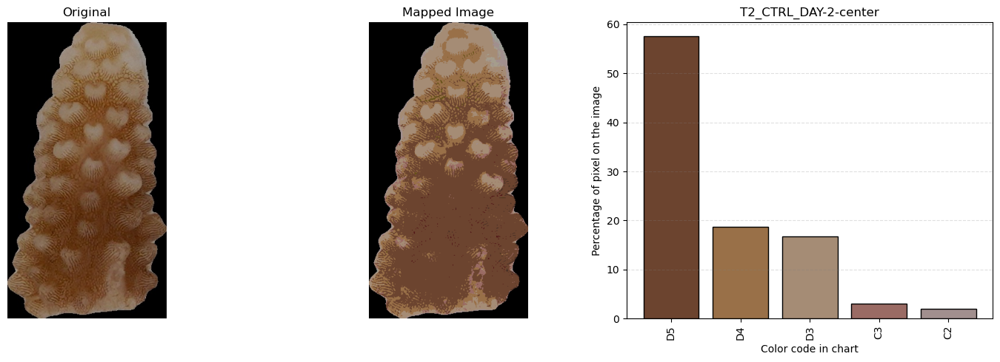

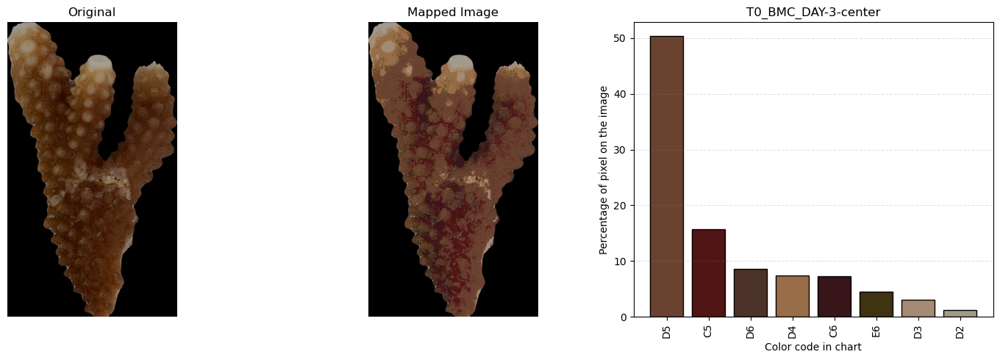

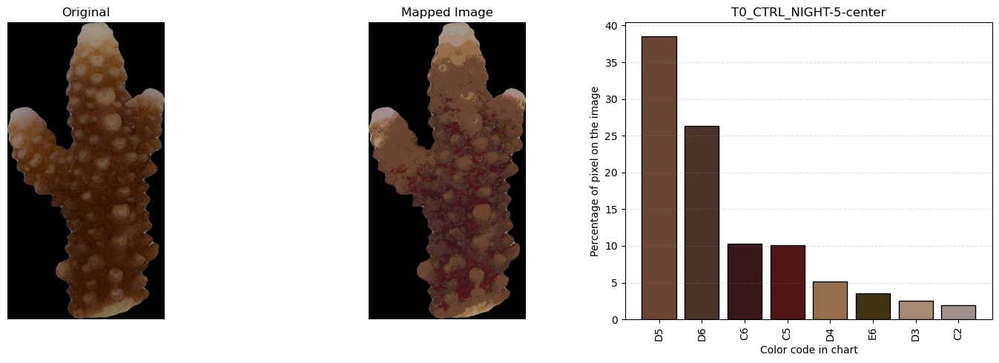

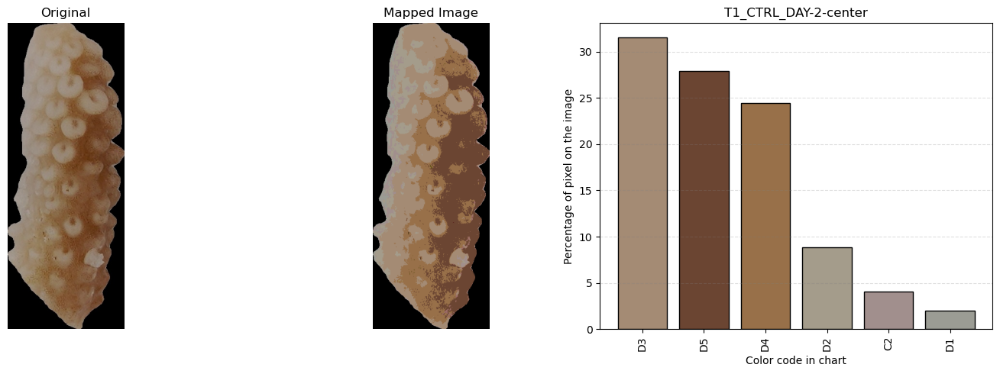

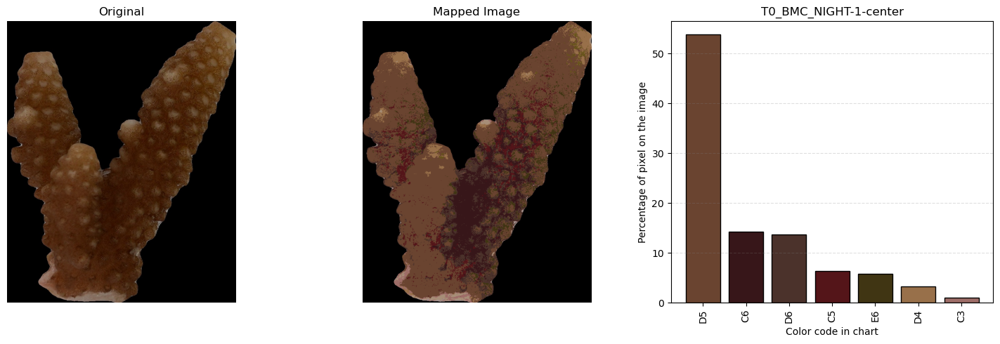

...

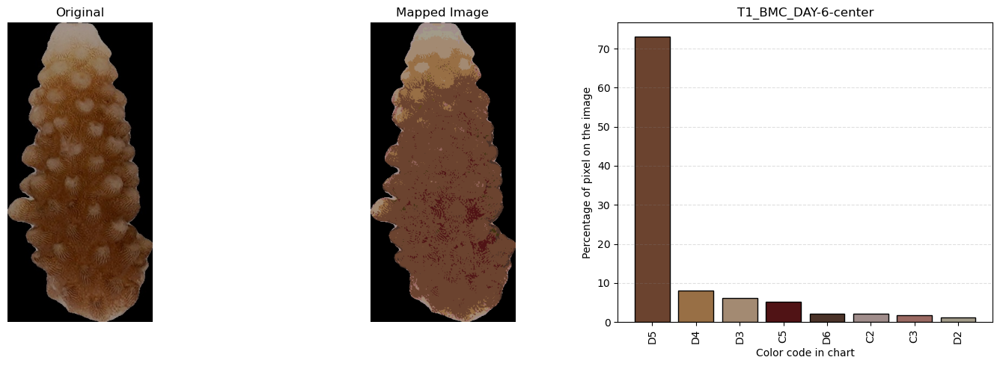

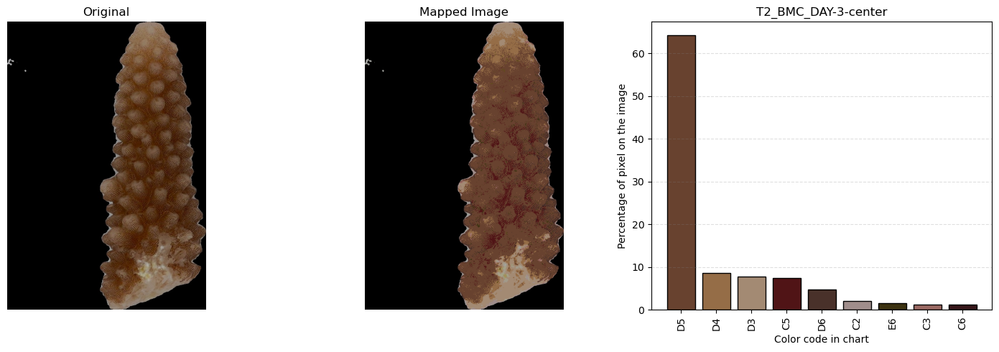

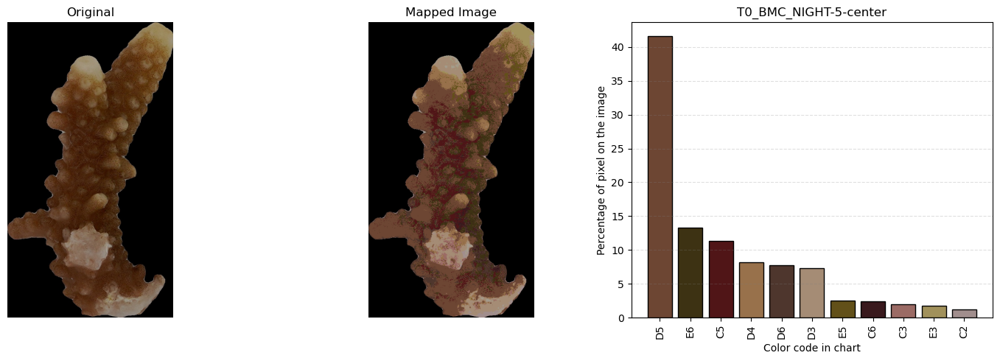

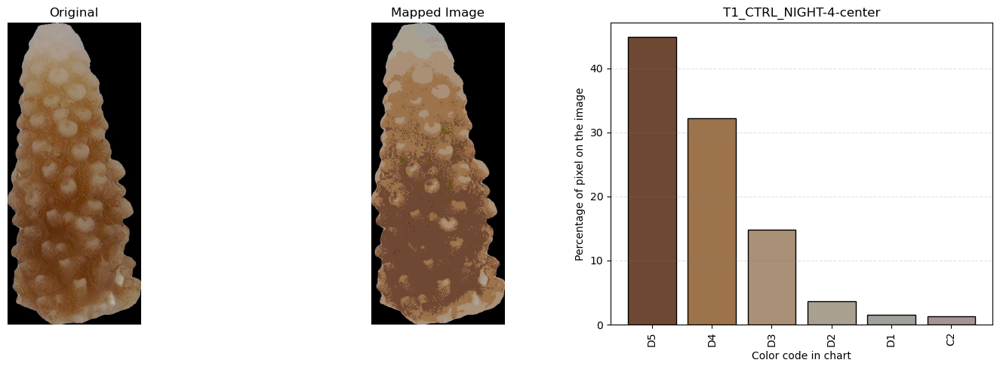

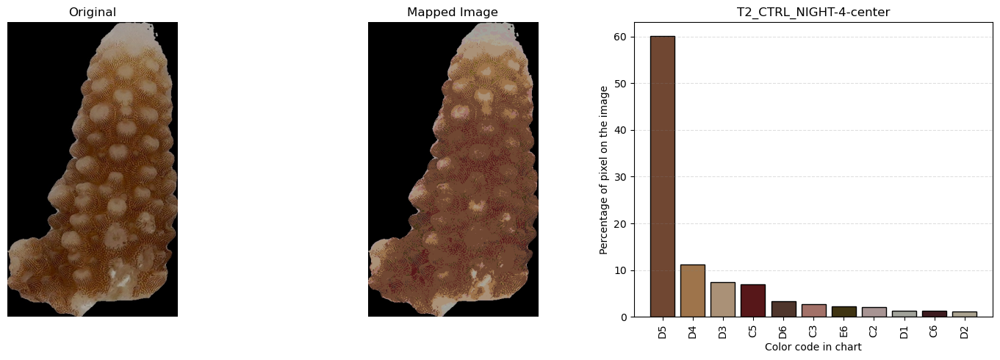

In [8]:
# %%
for im in list_of_center_segment_images_enhanced: 
#    # print (im)
    local_image = get_image(im)
    name = im.split("/")[-1]
    key = im.split("/")[-1].split("-center")[0]
    if len(custom_color_charts[key]) == 26:
        path_name = os.path.join(path_absolute_to_output,name)
        plot_compare_mapped_image_save( local_image,path_name,custom_color_charts[key])
    else:
        print (key,len(custom_color_charts[key]))

